A colour histogram h(.) can be generated by counting how many times each colour occurs in an image.
Histogram intersection can be used to match a pair of histograms. Given a pair of histograms, e.g., of an
input image I and a model M, each containing n bins, the intersection of the histograms is defined as  
∑ min[h(Ij), h(Mj)]
n
j=1
. 

In [21]:
import cv2
import math
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

a) Write a histogram function that returns the colour histogram of an input image. Visualize the histogram
and save the corresponding figure. For a given video sequence, use the above function to construct
the histogram of each frame.

In [22]:
def ICV_histogram(image, bins):
    #creating emppty array to store pixel count values
    red_hist = np.zeros((bins.shape[0]))
    green_hist = np.zeros((bins.shape[0]))
    blue_hist = np.zeros((bins.shape[0]))
    

    for i in range(bins.shape[0]):
        red_hist[i] = np.sum(image[:,:,0]==i)
        green_hist[i] = np.sum(image[:,:,1]==i)
        blue_hist[i] = np.sum(image[:,:,2]==i)
    
    return red_hist.ravel(),green_hist.ravel(),blue_hist.ravel()


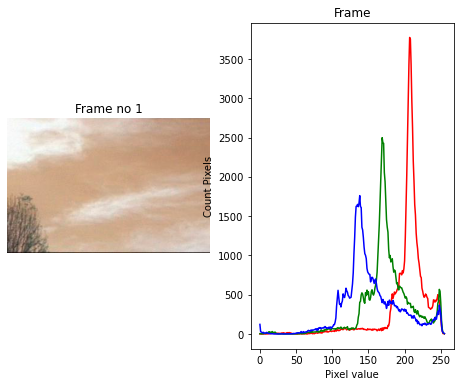

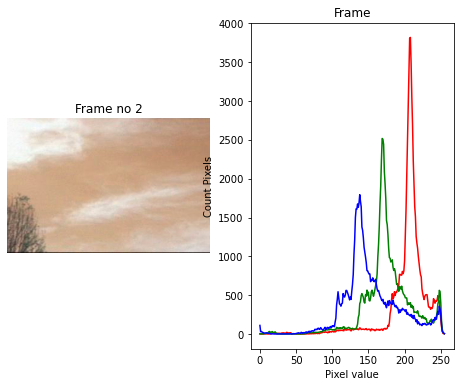

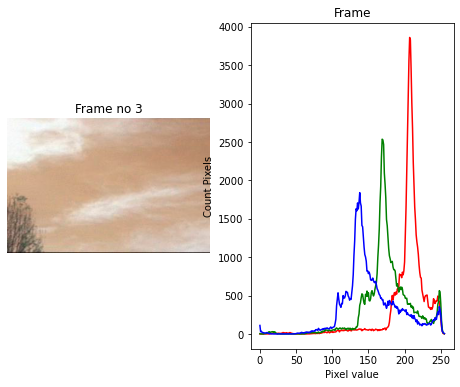

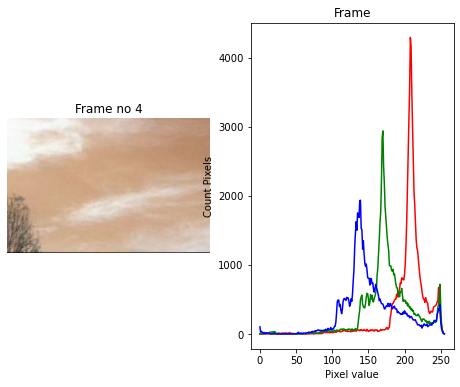

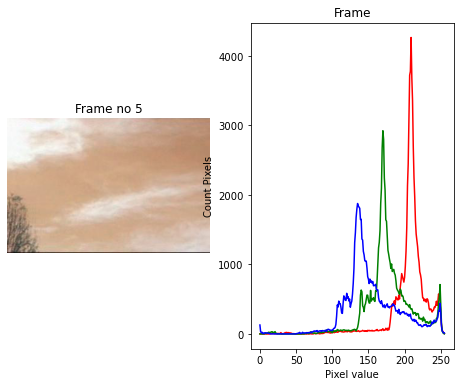

...

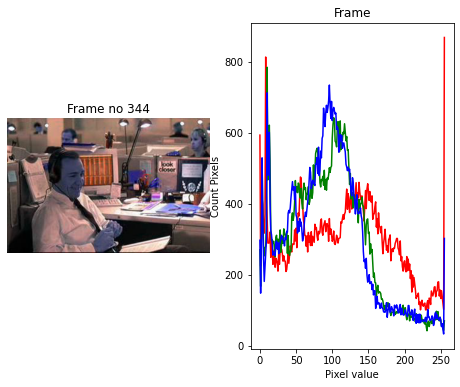

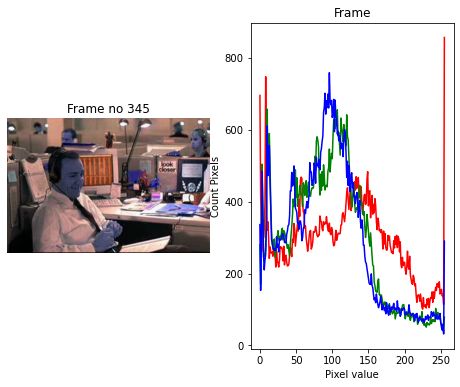

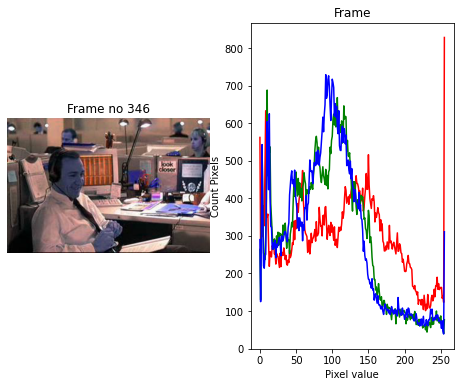

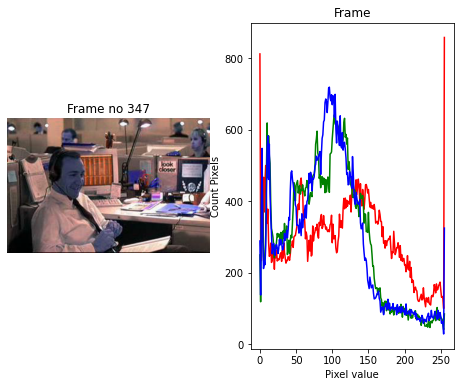

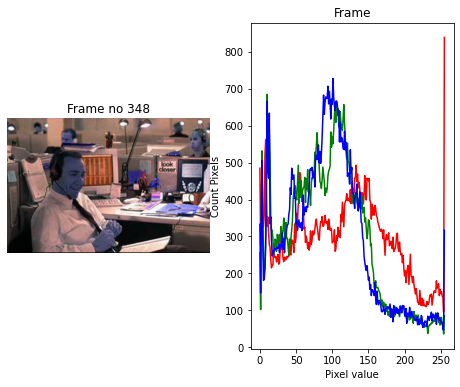

In [23]:
cap = cv2.VideoCapture('DatasetB.avi')
count_frame = 1
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret == True:
        #cv2.imshow('frame',frame)
        bins = np.arange(0,256)
        bins = bins.reshape(256,1).ravel()
    
        red_hist, green_hist, blue_hist = ICV_histogram(frame,bins)
        
        f = plt.figure(figsize=(8,6))
        f.add_subplot(1,2, 1)
        plt.axis('off')
        plt.imshow(frame)
        plt.title(f'Frame no {count_frame}')
        f.add_subplot(1,2, 2)
        plt.plot(bins, red_hist, color='red')
        plt.plot(bins, green_hist, color='green')
        plt.plot(bins, blue_hist, color='blue')
        plt.xlabel("Pixel value")
        plt.ylabel("Count Pixels")
        plt.title('Frame')
        plt.show()
        
        count_frame+=1
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break

cap.release()
cv2.destroyAllWindows()    


b) Write a function that returns the value of the intersection of a pair of histograms. For a given video
sequence, use the histogram intersection function to calculate the intersection between consecutive
frames (e.g. between It and It+1, between It+1 and It+2 and so on). Find how to normalize the
intersection. Does that change the results? Plot the intersection values over time and the normalised
intersection values, and save the corresponding figures. Show and comment the figures in the report.

In [24]:
def ICV_histogram_intersection(frame1, frame2):
    bins = np.arange(0,256)
    bins = bins.reshape(256,1)
    
    frame_1_red_hist, frame_1_green_hist, frame_1_blue_hist = ICV_histogram(frame1,bins)
    frame_2_red_hist, frame_2_green_hist, frame_2_blue_hist = ICV_histogram(frame2,bins)

    red_intersect = 0
    green_intersect = 0
    blue_intersect = 0
    
    for i in range(0,256):
        red_intersect += min(frame_1_red_hist[i],frame_2_red_hist[i])
        green_intersect += min(frame_1_green_hist[i],frame_2_green_hist[i])
        blue_intersect +=min(frame_1_blue_hist[i],frame_2_blue_hist[i])
    
    return red_intersect, green_intersect, blue_intersect
    

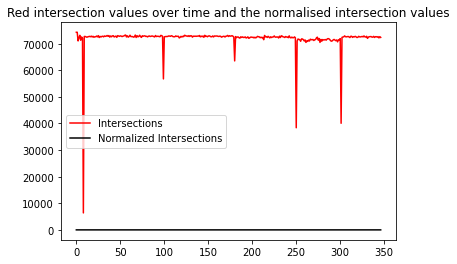

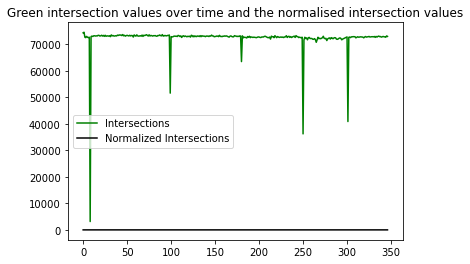

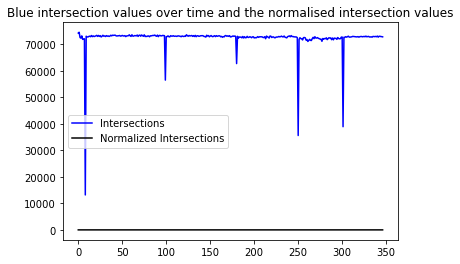

In [25]:
frames = []

cap = cv2.VideoCapture('DatasetB.avi')
while(cap.isOpened()):
    ret, frame = cap.read()
    if ret == True:
        #cv2.imshow('frame',frame)
        frames.append(frame)
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
    else:
        break

cap.release()
cv2.destroyAllWindows()    

red_intersects = []
green_intersects = []
blue_intersects = []

for i in range(1,len(frames)):
    red_intersect, green_intersect, blue_intersect = ICV_histogram_intersection(frames[i-1], frames[i])
    red_intersects.append(red_intersect)
    green_intersects.append(green_intersect)
    blue_intersects.append(blue_intersect)
    #print(f'Intersection between frame({i-1},{i}) Red={red_intersect} Blue={blue_intersect} Green={green_intersect}')
    
red_intersects = np.array(red_intersects)
green_intersects = np.array(green_intersects)
blue_intersects = np.array(blue_intersects)

red_intersect_normalize = np.zeros((red_intersects.shape))
green_intersect_normalize = np.zeros((green_intersects.shape))
blue_intersect_normalize = np.zeros((blue_intersects.shape))

red_intersect_normalize = (red_intersects - np.mean(red_intersects, axis = 0)) / np.std(red_intersects, axis = 0) 
green_intersect_normalize = (green_intersects - np.mean(green_intersects, axis = 0)) / np.std(green_intersects, axis = 0)
blue_intersect_normalize = (blue_intersects - np.mean(blue_intersects, axis = 0)) / np.std(blue_intersects, axis = 0)


plt.plot(range(red_intersects.shape[0]), red_intersects, color='red', label='Intersections')
plt.plot(range(red_intersect_normalize.shape[0]), red_intersect_normalize, color='black',label='Normalized Intersections')
plt.title('Red intersection values over time and the normalised intersection values')
plt.legend()
plt.show()

plt.plot(range(green_intersects.shape[0]), green_intersects, color='green', label='Intersections')
plt.plot(range(green_intersect_normalize.shape[0]), green_intersect_normalize, color='black',label='Normalized Intersections')
plt.title('Green intersection values over time and the normalised intersection values')
plt.legend()
plt.show()

plt.plot(range(blue_intersects.shape[0]), blue_intersects, color='blue', label='Intersections')
plt.plot(range(blue_intersect_normalize.shape[0]), blue_intersect_normalize, color='black',label='Normalized Intersections')
plt.title('Blue intersection values over time and the normalised intersection values')
plt.legend()
plt.show()


c) Discuss in the report the following: What does the intersection value represent for a given input video?
Can you use it to make a decision about scene changes? How robust to changes in the video is the
histogram intersection? When does it fail? 